##Pre-processing

In [1]:
import tensorflow as tf
import os
os.environ['PYTHONHASHSEED'] = '0'
import random
random.seed(13)
import numpy as np
from numpy.random import seed
seed(13)
from tensorflow.keras.utils import set_random_seed 
set_random_seed(13)
from importlib import reload
import sys
import warnings
warnings.filterwarnings('ignore')
if sys.version[0] == '2':
    reload(sys)
    sys.setdefaultencoding("utf-8")

import nltk
nltk.download('stopwords')
nltk.download('wordnet')

import re
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

#import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Concatenate, Dense, Input, LSTM, Embedding, Dropout, Activation, GRU, Flatten, Attention
from tensorflow.keras.layers import Bidirectional, GlobalMaxPool1D,MaxPooling1D,GlobalMaxPooling1D,SpatialDropout1D
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Convolution1D,TimeDistributed
from tensorflow.keras import initializers, regularizers, constraints, optimizers, layers
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from keras.layers import BatchNormalization, Conv1D
from keras.layers import Concatenate



[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


In [2]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import balanced_accuracy_score, accuracy_score,log_loss
from sklearn.preprocessing import label_binarize
from imblearn.over_sampling import SMOTE,SMOTEN
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from imblearn.over_sampling import *
import random
from sklearn.preprocessing import LabelEncoder,LabelBinarizer,OneHotEncoder
from keras.layers import LSTM, Lambda
import matplotlib.pyplot as plt
import numpy as np
import numpy as np
from tensorflow.keras.utils import to_categorical
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import (
    precision_score, 
    recall_score, 
    f1_score, 
    classification_report,
    accuracy_score
)
from sklearn.metrics import (
                             confusion_matrix,
                             roc_auc_score)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import nltk
nltk.download('punkt')
from tqdm import tqdm

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [3]:
from sklearn.metrics import matthews_corrcoef

In [4]:
!pip install --quiet shap==0.39
import shap

     |████████████████████████████████| 356 kB 4.2 MB/s 


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
import pandas as pd
all_df = pd.read_csv('/content/drive/My Drive/DataICADL_ALL_4300.csv')

In [7]:
!pip install sentencepiece gensim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.3 MB 4.2 MB/s 


In [8]:
all_df['label'].value_counts()

0    2238
1    1912
2     105
3      68
Name: label, dtype: int64

In [9]:
df_new = all_df[all_df['text'].notnull()]

In [10]:
df_new['text']=df_new['text'].apply(str)

In [11]:
df_new.text.apply(lambda x: len(x.split(" "))).mean()

13.34209913893414

In [12]:
#y = df_new['label'].values

In [13]:
Labels = { 0 : 0 , 1 : 1, 2: 1 , 3: 1 }

In [14]:
df_new['text_label'] = df_new['label'].map(Labels)

In [15]:
df_new['text_label'].value_counts()

0    2238
1    2059
Name: text_label, dtype: int64

In [16]:
#df_new=df_new.drop(columns='label')

In [17]:
#label_encoder = LabelEncoder()
#integer_encoded = label_encoder.fit_transform(df_new['text_label'])

In [18]:
#integer_encoded

In [19]:
#onehot_encoder = OneHotEncoder(sparse=False)
#integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
#onehot_encoded = onehot_encoder.fit_transform(integer_encoded)

In [20]:
#onehot_encoded

In [21]:
y=df_new['text_label']

In [22]:
#Y = df_new['text_label']
#Y = to_categorical(Y)
#Y

In [23]:
#Converting X to format acceptable by gensim, removing annd punctuation stopwords in the process
X = []
stop_words = set(nltk.corpus.stopwords.words("english"))
tokenizer = nltk.tokenize.RegexpTokenizer(r'\w+')
for par in df_new["text"].values:
    tmp = []
    sentences = nltk.word_tokenize(par)
    for sent in sentences:
        sent = sent.lower()
        tokens = tokenizer.tokenize(sent)
        filtered_words = [w.strip() for w in tokens if w not in stop_words and len(w) > 1]
        tmp.extend(filtered_words)
    X.append(tmp)

In [24]:
x_train, x_test, y_train, y_test = train_test_split(
    X, y, test_size=0.20, random_state=13579,stratify=y)
#x_train.shape, y_train.shape, x_test.shape, y_test.shape

In [25]:
tokenizer = Tokenizer(oov_token='oov')
tokenizer.fit_on_texts(x_train)

X_train = tokenizer.texts_to_sequences(x_train)
maxlen = 15
X_train = pad_sequences(X_train, maxlen=maxlen)
X_test = tokenizer.texts_to_sequences(x_test)
X_test = pad_sequences(X_test, maxlen=maxlen)

In [26]:
X_train.shape

(3437, 15)

In [27]:
y_train.shape

(3437,)

In [28]:
training = ['hey you there hello', 'well task complete', 'i am fine thanks', 'done logistic']
test = ['he is fine', 'i am fine too']


print(tokenizer.texts_to_sequences(all_df['text'][12]))

[[], [], [], [], [], [1], [1], [], [1], [1], [1], [], [], [], [], [1], [1], [], [1], [1], [], [1], [1], [1], [1], [1], [], [1], [1], [1], [1], [1], [1], [1], [1], [1], [1], [1], [1], [], [1], [1], [1], [], [1], [1], [1], [1], [1], [1], [], [1], [1], [1], [1], [], [1], [1], [1], [1]]


In [29]:
training = ['hey you there', 'how are you', 'i am fine thanks', 'hello there']
test = ['he is fine', 'i am fine too']


print(tokenizer.texts_to_sequences(training))
print(tokenizer.texts_to_sequences(test))

[[4716, 1, 1], [1, 1, 1], [1, 1, 696, 4105], [1, 1]]
[[1, 1, 696], [1, 1, 696, 1]]


In [30]:
import operator 

def check_coverage(vocab,embeddings_index):
    a = {}
    oov = {}
    k = 0
    i = 0
    for word in tqdm(vocab):
        try:
            a[word] = embeddings_index[word]
            k += vocab[word]
        except:

            oov[word] = vocab[word]
            i += vocab[word]
            pass

    print('Found embeddings for {:.2%} of vocab'.format(len(a) / len(vocab)))
    print('Found embeddings for  {:.2%} of all text'.format(k / (k + i)))
    sorted_x = sorted(oov.items(), key=operator.itemgetter(1))[::-1]

    return sorted_x

In [31]:
import itertools

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.get_cmap("coolwarm")):
    """
    This function will print and plot the confusion matrix.
    You can set normalization by changing the setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
cm_labels_plot = ['Negative','Positive']

In [32]:
def metrics(pred_tag, y_test):
    print("F1-score: ", f1_score(pred_tag, y_test))
    print("Precision: ", precision_score(pred_tag, y_test))
    print("Recall: ", recall_score(pred_tag, y_test))
    print("Acuracy: ", accuracy_score(pred_tag, y_test))
    print("-"*50)
    print(classification_report(pred_tag, y_test))

In [33]:
def get_classification_report(y_test, y_pred):
    from sklearn import metrics
    report = metrics.classification_report(y_test, y_pred, output_dict=True)
    df_classification_report = pd.DataFrame(report).transpose()
    df_classification_report = df_classification_report.sort_values(by=['f1-score'], ascending=False)
    return df_classification_report

In [34]:
!pip install lime --quiet

     |████████████████████████████████| 275 kB 4.2 MB/s 


In [35]:
from lime.lime_text import LimeTextExplainer
class_names=['negative','positive']
explainer= LimeTextExplainer(class_names=class_names)


In [36]:
def new_predict(texts):
 seq = tokenizer.texts_to_sequences(texts)
 text_data = pad_sequences(seq, maxlen=15)
 return model.predict(text_data)

In [37]:
#Converting X to format acceptable by gensim, removing annd punctuation stopwords in the process
def to_shap(df):
  X1 = []
  stop_words1 = set(nltk.corpus.stopwords.words("english"))
  tokenizer1 = nltk.tokenize.RegexpTokenizer(r'\w+')
  for par1 in df["text"].values:
      tmp1 = []
      sentences1 = nltk.word_tokenize(par1)
      for sent1 in sentences1:
          sent1 = sent1.lower()
          tokens1 = tokenizer1.tokenize(sent1)
          filtered_words1 = [w.strip() for w in tokens1 if w not in stop_words and len(w) > 1]
          tmp1.extend(filtered_words1)
      X1.append(tmp1)
  return X1

In [38]:
def func(texts):
 seq = tokenizer.texts_to_sequences(texts)
 text_data = pad_sequences(seq, maxlen=15)
 return text_data

#BioWordVec

In [39]:
from gensim.models.keyedvectors import KeyedVectors

In [40]:
word_index = tokenizer.word_index
for word, num in word_index.items():
    print(f"{word} -> {num}")
    if num == 10:
        break       

oov -> 1
algorithm -> 2
time -> 3
data -> 4
results -> 5
number -> 6
set -> 7
used -> 8
algorithms -> 9
method -> 10


In [41]:
vocab_size = len(tokenizer.word_index) + 1

In [42]:
vocab_size

4891

In [43]:
# Takes RAM 
word_vectors = KeyedVectors.load_word2vec_format('/content/drive/MyDrive/BioWordVec_PubMed_MIMICIII_d200.vec.bin', 
                                                 binary=True)


In [44]:
EMBEDDING_DIM_bv=200
EMBEDDING_DIM =200

In [45]:
embedding_matrix_bv = np.zeros((vocab_size, EMBEDDING_DIM_bv))
for word, i in word_index.items():
    try:
        embedding_vector = word_vectors[word]
        embedding_matrix_bv[i] = embedding_vector
    except KeyError:
        embedding_matrix_bv[i]=np.random.normal(0,np.sqrt(0.25),EMBEDDING_DIM_bv)

In [46]:
oov = check_coverage(tokenizer.word_index,word_vectors)

100%|██████████| 4890/4890 [00:00<00:00, 356642.38it/s]

Found embeddings for 97.14% of vocab
Found embeddings for  96.17% of all text


In [47]:
del word_vectors

In [48]:
import gc
gc.collect()

44

#CNN bio

In [62]:
model = Sequential()
model.add(Embedding(vocab_size, output_dim=200, 
                    weights=[embedding_matrix_bv], input_length=maxlen, trainable=True))
model.add(Conv1D(filters=128, kernel_size=4, padding='same', activation='relu'))
model.add(MaxPooling1D(pool_size=2))
model.add(Conv1D(filters=64, kernel_size=4, padding='same', activation='relu'))
model.add(MaxPooling1D(pool_size=2))
model.add(Conv1D(filters=32, kernel_size=4, padding='same', activation='relu'))
model.add(MaxPooling1D(pool_size=2))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.summary()
opt = keras.optimizers.Adam(learning_rate=0.01)
model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
earlystop_cb = [keras.callbacks.EarlyStopping(patience = 10,monitor='val_accuracy'),keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy',
                                factor=0.1, patience=5, min_lr=1e-3)] 

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (None, 15, 200)           978200    
                                                                 
 conv1d_6 (Conv1D)           (None, 15, 128)           102528    
                                                                 
 max_pooling1d_6 (MaxPooling  (None, 7, 128)           0         
 1D)                                                             
                                                                 
 conv1d_7 (Conv1D)           (None, 7, 64)             32832     
                                                                 
 max_pooling1d_7 (MaxPooling  (None, 3, 64)            0         
 1D)                                                             
                                                                 
 conv1d_8 (Conv1D)           (None, 3, 32)            

In [63]:
num_epochs = 50
history = model.fit(X_train, y_train,
                       epochs=num_epochs,
                       validation_split=0.2
                       , callbacks=[earlystop_cb],verbose=2)

Epoch 1/50
86/86 - 1s - loss: 0.6963 - accuracy: 0.5293 - val_loss: 0.6456 - val_accuracy: 0.6483 - lr: 0.0100 - 1s/epoch - 17ms/step
Epoch 2/50
86/86 - 1s - loss: 0.4461 - accuracy: 0.7977 - val_loss: 0.5477 - val_accuracy: 0.7529 - lr: 0.0100 - 517ms/epoch - 6ms/step
Epoch 3/50
86/86 - 1s - loss: 0.1509 - accuracy: 0.9487 - val_loss: 0.6083 - val_accuracy: 0.7776 - lr: 0.0100 - 532ms/epoch - 6ms/step
Epoch 4/50
86/86 - 1s - loss: 0.0582 - accuracy: 0.9854 - val_loss: 1.1466 - val_accuracy: 0.7398 - lr: 0.0100 - 528ms/epoch - 6ms/step
Epoch 5/50
86/86 - 1s - loss: 0.0559 - accuracy: 0.9844 - val_loss: 1.3293 - val_accuracy: 0.7558 - lr: 0.0100 - 520ms/epoch - 6ms/step
Epoch 6/50
86/86 - 1s - loss: 0.0357 - accuracy: 0.9887 - val_loss: 1.3267 - val_accuracy: 0.7573 - lr: 0.0100 - 517ms/epoch - 6ms/step
Epoch 7/50
86/86 - 1s - loss: 0.0336 - accuracy: 0.9935 - val_loss: 0.8662 - val_accuracy: 0.7645 - lr: 0.0100 - 527ms/epoch - 6ms/step
Epoch 8/50
86/86 - 1s - loss: 0.1824 - accuracy: 0

In [64]:
prediction = model.predict(X_test)
y_pred=np.argmax(prediction, axis=1)
cm = confusion_matrix(y_true=y_test, y_pred=y_pred)

Confusion matrix, without normalization
[[369  79]
 [116 296]]


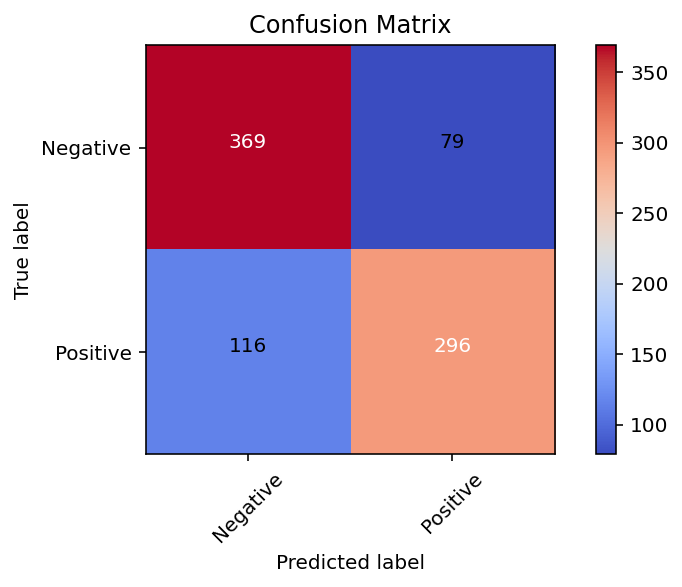

In [65]:
plot_confusion_matrix(cm=cm, classes=cm_labels_plot, title='Confusion Matrix')

In [66]:
report = classification_report(y_test,y_pred,target_names=['Negative','Positive'])
print(report)

              precision    recall  f1-score   support

    Negative       0.76      0.82      0.79       448
    Positive       0.79      0.72      0.75       412

    accuracy                           0.77       860
   macro avg       0.78      0.77      0.77       860
weighted avg       0.77      0.77      0.77       860



In [67]:
cnn_scores_df_bio = pd.DataFrame(
    dict(

       acc_test= accuracy_score(y_test, y_pred),
        F1_score = f1_score(y_test, y_pred),
        recall = recall_score(y_test,y_pred),
        precision = precision_score(y_test, y_pred),
        MCC = matthews_corrcoef(y_test, y_pred)
    ), 
    index=['CNN Bio']
)
cnn_scores_df_bio

,acc_test,F1_score,recall,precision,MCC
CNN Bio,0.773256,0.752224,0.718447,0.789333,0.546118


##Lime

In [68]:
exp=explainer.explain_instance(all_df['text'][3228], new_predict).show_in_notebook(text=True)#1

In [69]:
exp=explainer.explain_instance(all_df['text'][1777], new_predict).show_in_notebook(text=True)#1

In [70]:
exp=explainer.explain_instance(all_df['text'][1779], new_predict,).show_in_notebook(text=True)#0

##Shap

In [71]:
tex=[3228,1777,1779]

In [72]:
df=all_df.iloc[tex]

In [73]:
X_values = to_shap(df)
df_shap = func(X_values)

In [74]:
kernel_explainer = shap.KernelExplainer(model.predict, shap.sample(X_train, 100))
kernel_shap_values = kernel_explainer.shap_values(df_shap)

  0%|          | 0/3 [00:00<?, ?it/s]

In [75]:
shap.initjs()
# create dict to invert word_idx k,v order
num2word = {}
for w in word_index.keys():
    num2word[word_index[w]] = w
x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "oov"), df_shap[i]))) for i in range(3)])

In [76]:
shap.initjs()
class_num = 1
input_num = 0
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [77]:
shap.initjs()
class_num = 1
input_num = 1
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [78]:
shap.initjs()
class_num = 1
input_num = 2
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

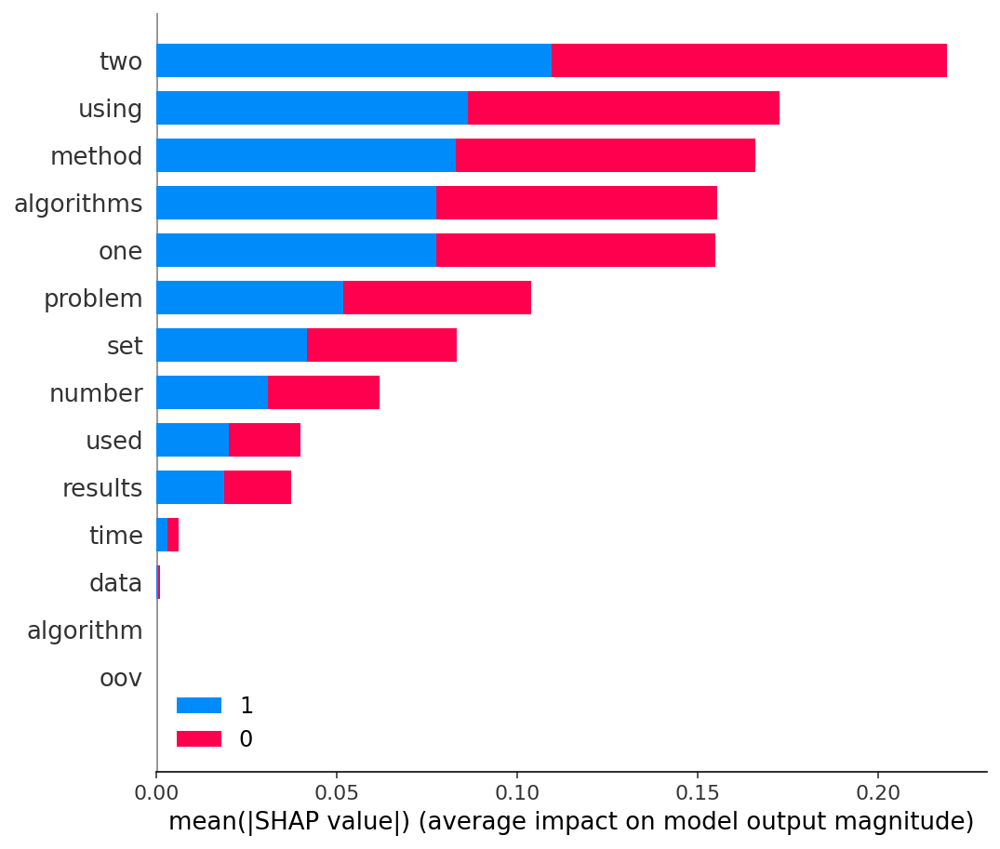

In [79]:
words = word_index
word_lookup = list()
for i in words.keys():
  word_lookup.append(i)
word_lookup = [''] + word_lookup
shap.summary_plot(kernel_shap_values, feature_names=word_lookup, class_names=(0,1))

#LSTM bio

In [105]:
model = Sequential()
model.add(Embedding(vocab_size, output_dim=EMBEDDING_DIM, 
                    weights=[embedding_matrix_bv], input_length=maxlen, trainable=True))
model.add(SpatialDropout1D(0.2))
model.add(LSTM(100, dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(2, activation='softmax'))
model.summary()
opt = keras.optimizers.Adam(learning_rate=0.01)
model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
earlystop_cb = [keras.callbacks.EarlyStopping(patience = 10,monitor='val_accuracy'),keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy',
                                factor=0.1, patience=5, min_lr=1e-3)] 

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (None, 15, 200)           978200    
                                                                 
 spatial_dropout1d_4 (Spatia  (None, 15, 200)          0         
 lDropout1D)                                                     
                                                                 
 lstm_4 (LSTM)               (None, 100)               120400    
                                                                 
 dense_10 (Dense)            (None, 2)                 202       
                                                                 
Total params: 1,098,802
Trainable params: 1,098,802
Non-trainable params: 0
_________________________________________________________________


In [106]:
num_epochs = 50
history = model.fit(X_train, y_train,
                       epochs=num_epochs,
                       validation_split=0.2
                       , callbacks=[earlystop_cb],verbose=2)

Epoch 1/50
86/86 - 12s - loss: 0.6236 - accuracy: 0.6362 - val_loss: 0.5503 - val_accuracy: 0.7311 - lr: 0.0100 - 12s/epoch - 135ms/step
Epoch 2/50
86/86 - 7s - loss: 0.2675 - accuracy: 0.8967 - val_loss: 0.5954 - val_accuracy: 0.7791 - lr: 0.0100 - 7s/epoch - 81ms/step
Epoch 3/50
86/86 - 7s - loss: 0.0967 - accuracy: 0.9676 - val_loss: 0.7135 - val_accuracy: 0.7747 - lr: 0.0100 - 7s/epoch - 81ms/step
Epoch 4/50
86/86 - 7s - loss: 0.0348 - accuracy: 0.9876 - val_loss: 1.0215 - val_accuracy: 0.7805 - lr: 0.0100 - 7s/epoch - 81ms/step
Epoch 5/50
86/86 - 7s - loss: 0.0189 - accuracy: 0.9927 - val_loss: 1.0418 - val_accuracy: 0.7776 - lr: 0.0100 - 7s/epoch - 82ms/step
Epoch 6/50
86/86 - 7s - loss: 0.0156 - accuracy: 0.9945 - val_loss: 1.2182 - val_accuracy: 0.7834 - lr: 0.0100 - 7s/epoch - 80ms/step
Epoch 7/50
86/86 - 7s - loss: 0.0137 - accuracy: 0.9949 - val_loss: 1.4680 - val_accuracy: 0.7733 - lr: 0.0100 - 7s/epoch - 81ms/step
Epoch 8/50
86/86 - 7s - loss: 0.0115 - accuracy: 0.9956 - v

In [107]:
prediction = model.predict(X_test)
y_pred=np.argmax(prediction, axis=1)
cm = confusion_matrix(y_true=y_test, y_pred=y_pred)

Confusion matrix, without normalization
[[350  98]
 [ 95 317]]


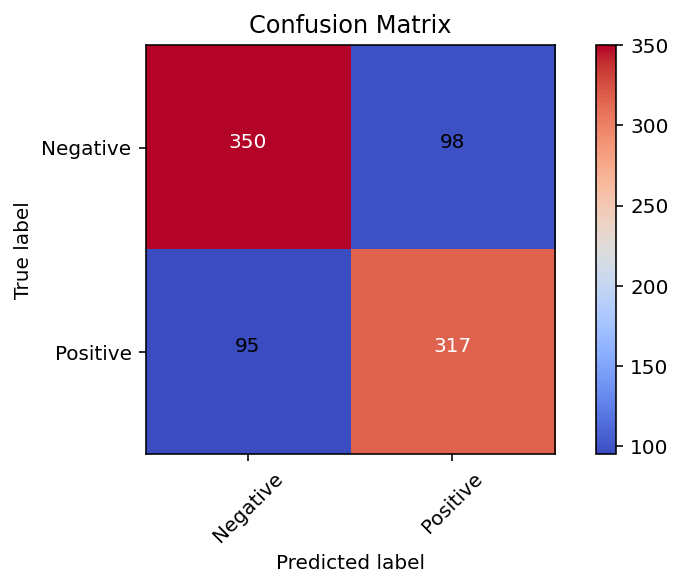

In [108]:
plot_confusion_matrix(cm=cm, classes=cm_labels_plot, title='Confusion Matrix')

In [109]:
report = classification_report(y_test,y_pred,target_names=['Negative','Positive'])
print(report)

              precision    recall  f1-score   support

    Negative       0.79      0.78      0.78       448
    Positive       0.76      0.77      0.77       412

    accuracy                           0.78       860
   macro avg       0.78      0.78      0.78       860
weighted avg       0.78      0.78      0.78       860



In [110]:
lstm_scores_df_bio = pd.DataFrame(
    dict(

        acc_test= accuracy_score(y_test, y_pred),
        F1_score = f1_score(y_test, y_pred),
        recall = recall_score(y_test,y_pred),
        precision = precision_score(y_test, y_pred),
        MCC = matthews_corrcoef(y_test, y_pred)
    ), 
    index=['LSTM Bio']
)
lstm_scores_df_bio

,acc_test,F1_score,recall,precision,MCC
LSTM Bio,0.775581,0.766626,0.769417,0.763855,0.55052


##Lime

In [111]:
exp=explainer.explain_instance(all_df['text'][3228], new_predict).show_in_notebook(text=True)#1

In [112]:
exp=explainer.explain_instance(all_df['text'][1824], new_predict).show_in_notebook(text=True)#1

In [113]:
exp=explainer.explain_instance(all_df['text'][1825], new_predict,).show_in_notebook(text=True)#0

##Shap

In [114]:
tex=[3228,1824,1825]

In [115]:
df=all_df.iloc[tex]

In [116]:
X_values = to_shap(df)
df_shap = func(X_values)

In [117]:
kernel_explainer = shap.KernelExplainer(model.predict, shap.sample(X_train, 100))
kernel_shap_values = kernel_explainer.shap_values(df_shap)

  0%|          | 0/3 [00:00<?, ?it/s]

In [118]:
shap.initjs()
# create dict to invert word_idx k,v order
num2word = {}
for w in word_index.keys():
    num2word[word_index[w]] = w
x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "oov"), df_shap[i]))) for i in range(3)])

In [119]:
shap.initjs()
class_num = 1
input_num = 0
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [120]:
shap.initjs()
class_num = 1
input_num = 1
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [121]:
shap.initjs()
class_num = 1
input_num = 2
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

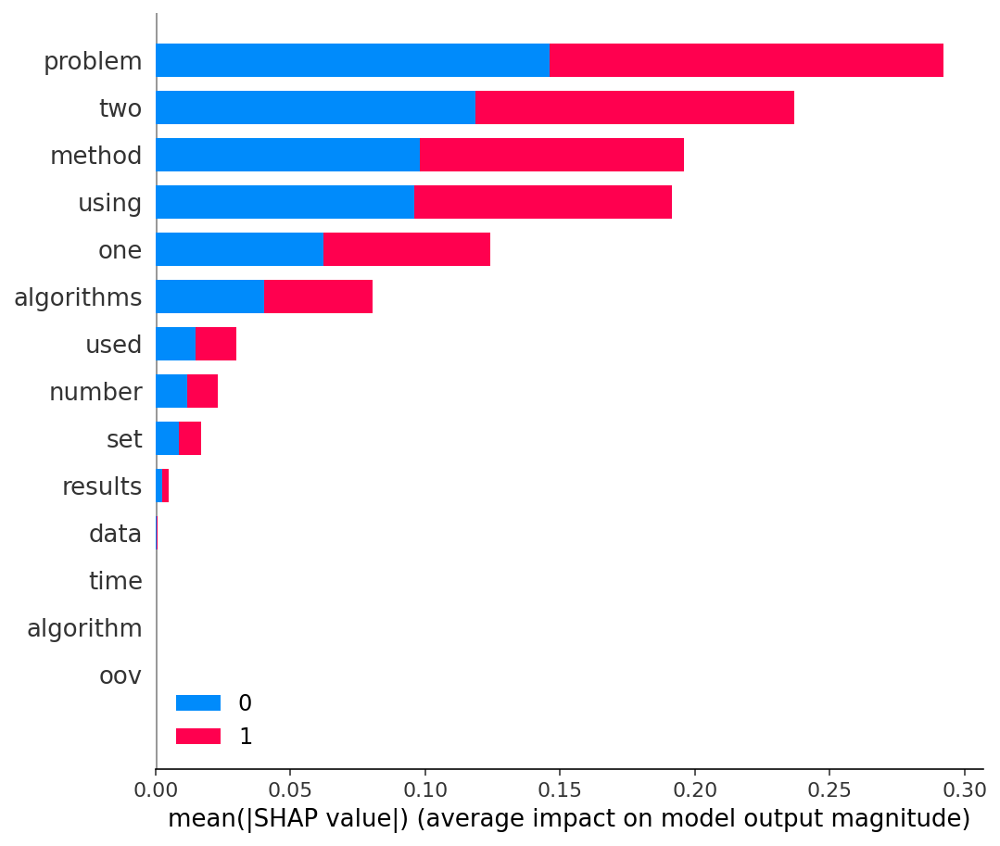

In [122]:
words = word_index
word_lookup = list()
for i in words.keys():
  word_lookup.append(i)
word_lookup = [''] + word_lookup
shap.summary_plot(kernel_shap_values, feature_names=word_lookup, class_names=(0,1))

#GRU bio

In [129]:
model = Sequential()
model.add(Embedding(vocab_size, output_dim=EMBEDDING_DIM, 
                    weights=[embedding_matrix_bv]
                    , input_length=maxlen, trainable=True))
model.add(Dropout(0.5))
model.add((GRU(300, dropout=0.5)))
model.add(Dense(2, activation='softmax'))
model.summary()
opt = keras.optimizers.Adam(learning_rate=0.01)
model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
earlystop_cb = [keras.callbacks.EarlyStopping(patience = 10,monitor='val_accuracy'),keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy',
                                factor=0.1, patience=5, min_lr=1e-3)] 

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_9 (Embedding)     (None, 15, 200)           978200    
                                                                 
 dropout_1 (Dropout)         (None, 15, 200)           0         
                                                                 
 gru_1 (GRU)                 (None, 300)               451800    
                                                                 
 dense_12 (Dense)            (None, 2)                 602       
                                                                 
Total params: 1,430,602
Trainable params: 1,430,602
Non-trainable params: 0
_________________________________________________________________


In [130]:
num_epochs = 50
historyGRU = model.fit(X_train, y_train,
                       epochs=num_epochs,
                       validation_split=0.2
                       , callbacks=[earlystop_cb],verbose=2)

Epoch 1/50
86/86 - 3s - loss: 0.7090 - accuracy: 0.6082 - val_loss: 0.5730 - val_accuracy: 0.6991 - lr: 0.0100 - 3s/epoch - 35ms/step
Epoch 2/50
86/86 - 0s - loss: 0.5050 - accuracy: 0.7592 - val_loss: 0.6084 - val_accuracy: 0.7238 - lr: 0.0100 - 493ms/epoch - 6ms/step
Epoch 3/50
86/86 - 0s - loss: 0.3636 - accuracy: 0.8429 - val_loss: 0.6423 - val_accuracy: 0.7442 - lr: 0.0100 - 482ms/epoch - 6ms/step
Epoch 4/50
86/86 - 0s - loss: 0.2662 - accuracy: 0.8938 - val_loss: 0.6022 - val_accuracy: 0.7544 - lr: 0.0100 - 498ms/epoch - 6ms/step
Epoch 5/50
86/86 - 0s - loss: 0.1827 - accuracy: 0.9305 - val_loss: 0.8360 - val_accuracy: 0.7660 - lr: 0.0100 - 487ms/epoch - 6ms/step
Epoch 6/50
86/86 - 0s - loss: 0.1507 - accuracy: 0.9429 - val_loss: 0.9070 - val_accuracy: 0.7878 - lr: 0.0100 - 492ms/epoch - 6ms/step
Epoch 7/50
86/86 - 0s - loss: 0.1264 - accuracy: 0.9560 - val_loss: 1.0558 - val_accuracy: 0.7544 - lr: 0.0100 - 484ms/epoch - 6ms/step
Epoch 8/50
86/86 - 0s - loss: 0.1083 - accuracy: 0

In [131]:
prediction = model.predict(X_test)
y_pred=np.argmax(prediction, axis=1)
cm = confusion_matrix(y_true=y_test, y_pred=y_pred)

Confusion matrix, without normalization
[[352  96]
 [ 87 325]]


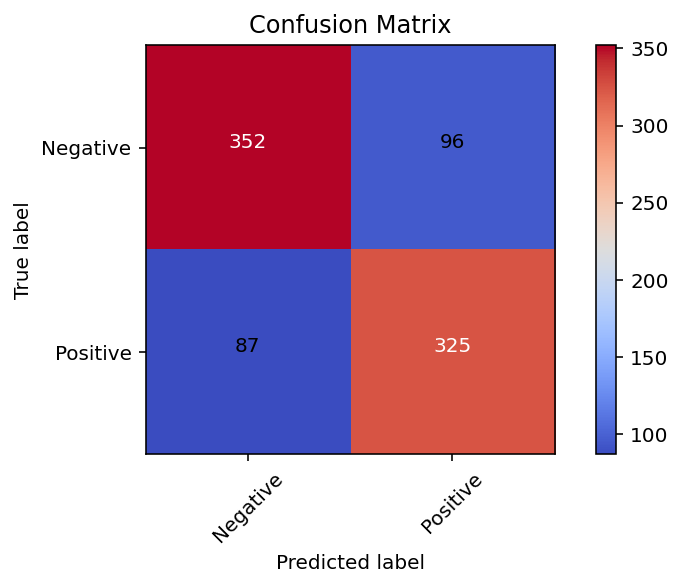

In [132]:
plot_confusion_matrix(cm=cm, classes=cm_labels_plot, title='Confusion Matrix')

In [133]:
report = classification_report(y_test,y_pred,target_names=['Negative','Positive'])
print(report)

              precision    recall  f1-score   support

    Negative       0.80      0.79      0.79       448
    Positive       0.77      0.79      0.78       412

    accuracy                           0.79       860
   macro avg       0.79      0.79      0.79       860
weighted avg       0.79      0.79      0.79       860



In [134]:
gru_scores_df_bio = pd.DataFrame(
    dict(

       acc_test= accuracy_score(y_test, y_pred),
        F1_score = f1_score(y_test, y_pred),
        recall = recall_score(y_test,y_pred),
        precision = precision_score(y_test, y_pred),
        MCC = matthews_corrcoef(y_test, y_pred)
    ), 
    index=['GRU Bio']
)
gru_scores_df_bio

,acc_test,F1_score,recall,precision,MCC
GRU Bio,0.787209,0.780312,0.788835,0.771971,0.574171


##Lime

In [135]:
exp=explainer.explain_instance(all_df['text'][3228], new_predict).show_in_notebook(text=True)#1

In [136]:
exp=explainer.explain_instance(all_df['text'][1924], new_predict).show_in_notebook(text=True)#1

In [137]:
exp=explainer.explain_instance(all_df['text'][1923], new_predict,).show_in_notebook(text=True)#0

##Shap

In [138]:
tex=[3228,1924,1923]

In [139]:
df=all_df.iloc[tex]

In [140]:
X_values = to_shap(df)
df_shap = func(X_values)

In [141]:
kernel_explainer = shap.KernelExplainer(model.predict, shap.sample(X_train, 100))
kernel_shap_values = kernel_explainer.shap_values(df_shap)

  0%|          | 0/3 [00:00<?, ?it/s]

In [142]:
shap.initjs()
# create dict to invert word_idx k,v order
num2word = {}
for w in word_index.keys():
    num2word[word_index[w]] = w
x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "oov"), df_shap[i]))) for i in range(3)])

In [143]:
shap.initjs()
class_num = 1
input_num = 0
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [144]:
shap.initjs()
class_num = 1
input_num = 1
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [145]:
shap.initjs()
class_num = 1
input_num = 2
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

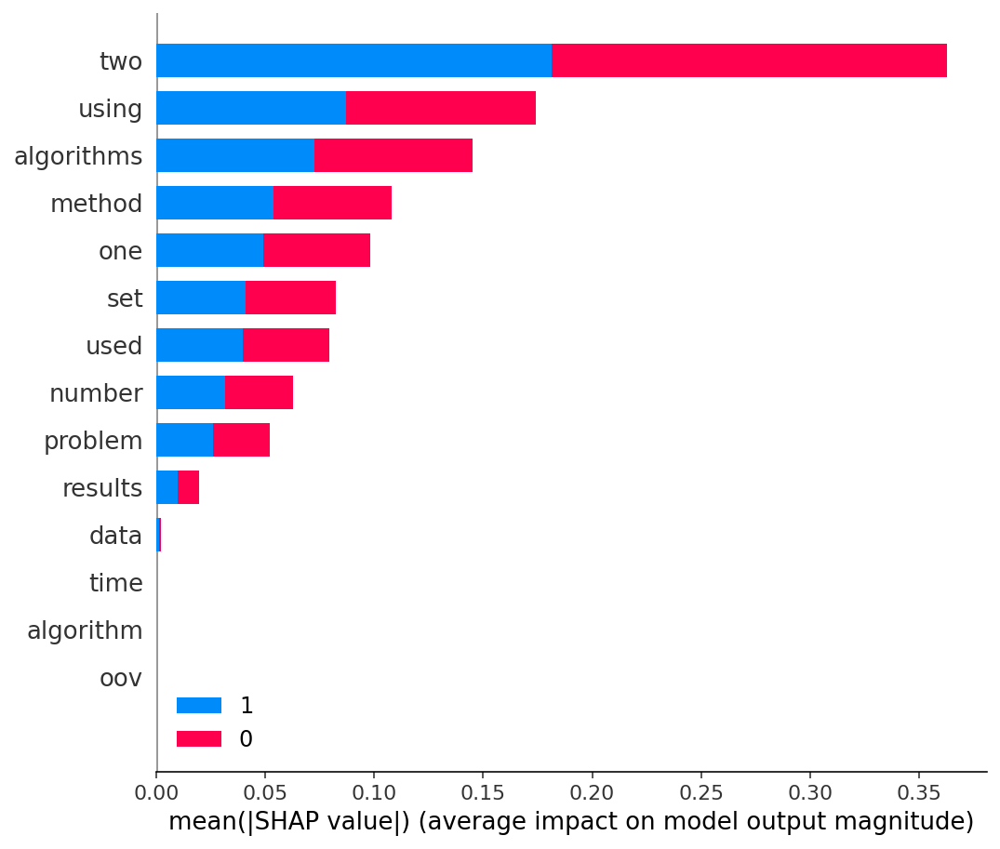

In [146]:
words = word_index
word_lookup = list()
for i in words.keys():
  word_lookup.append(i)
word_lookup = [''] + word_lookup
shap.summary_plot(kernel_shap_values, feature_names=word_lookup, class_names=(0,1))

#Bilstm bio

In [167]:
model = Sequential()
model.add(Embedding(vocab_size, output_dim=EMBEDDING_DIM, 
                    weights=[embedding_matrix_bv], input_length=15, trainable=True))
model.add(Dropout(0.5))
model.add(Bidirectional(LSTM(100, dropout=0.3, recurrent_dropout=0.2)))
model.add(Dense(2, activation='softmax'))
model.summary()
opt = keras.optimizers.Adam(learning_rate=0.01)
model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
earlystop_cb = [keras.callbacks.EarlyStopping(patience = 10,monitor='val_accuracy'),keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy',
                                factor=0.1, patience=5, min_lr=1e-3)] 

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_13 (Embedding)    (None, 15, 200)           978200    
                                                                 
 dropout_5 (Dropout)         (None, 15, 200)           0         
                                                                 
 bidirectional_3 (Bidirectio  (None, 200)              240800    
 nal)                                                            
                                                                 
 dense_16 (Dense)            (None, 2)                 402       
                                                                 
Total params: 1,219,402
Trainable params: 1,219,402
Non-trainable params: 0
_________________________________________________________________


In [168]:
num_epochs = 50
history = model.fit(X_train, y_train,
                       epochs=num_epochs,
                       validation_split=0.2
                       , callbacks=[earlystop_cb],verbose=2)

Epoch 1/50
86/86 - 19s - loss: 0.6470 - accuracy: 0.6224 - val_loss: 0.6056 - val_accuracy: 0.6860 - lr: 0.0100 - 19s/epoch - 218ms/step
Epoch 2/50
86/86 - 13s - loss: 0.3593 - accuracy: 0.8483 - val_loss: 0.5579 - val_accuracy: 0.7529 - lr: 0.0100 - 13s/epoch - 156ms/step
Epoch 3/50
86/86 - 13s - loss: 0.1907 - accuracy: 0.9240 - val_loss: 0.6164 - val_accuracy: 0.7674 - lr: 0.0100 - 13s/epoch - 152ms/step
Epoch 4/50
86/86 - 13s - loss: 0.1093 - accuracy: 0.9578 - val_loss: 0.8237 - val_accuracy: 0.7791 - lr: 0.0100 - 13s/epoch - 149ms/step
Epoch 5/50
86/86 - 13s - loss: 0.0700 - accuracy: 0.9789 - val_loss: 0.8249 - val_accuracy: 0.7776 - lr: 0.0100 - 13s/epoch - 149ms/step
Epoch 6/50
86/86 - 13s - loss: 0.0425 - accuracy: 0.9865 - val_loss: 0.9779 - val_accuracy: 0.7718 - lr: 0.0100 - 13s/epoch - 149ms/step
Epoch 7/50
86/86 - 13s - loss: 0.0365 - accuracy: 0.9898 - val_loss: 1.0937 - val_accuracy: 0.7776 - lr: 0.0100 - 13s/epoch - 148ms/step
Epoch 8/50
86/86 - 13s - loss: 0.0209 - a

In [169]:
prediction = model.predict(X_test)
y_pred=np.argmax(prediction, axis=1)
cm = confusion_matrix(y_true=y_test, y_pred=y_pred)

Confusion matrix, without normalization
[[373  75]
 [109 303]]


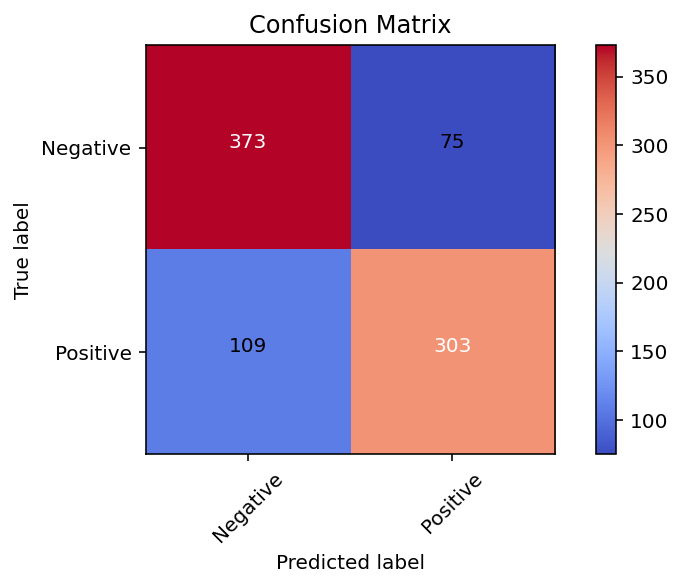

In [170]:
plot_confusion_matrix(cm=cm, classes=cm_labels_plot, title='Confusion Matrix')

In [171]:
report = classification_report(y_test,y_pred,target_names=['Negative','Positive'])
print(report)

              precision    recall  f1-score   support

    Negative       0.77      0.83      0.80       448
    Positive       0.80      0.74      0.77       412

    accuracy                           0.79       860
   macro avg       0.79      0.78      0.78       860
weighted avg       0.79      0.79      0.79       860



In [172]:
bilstm_scores_df_bio = pd.DataFrame(
    dict(

        acc_test= accuracy_score(y_test, y_pred),
        F1_score = f1_score(y_test, y_pred),
        recall = recall_score(y_test,y_pred),
        precision = precision_score(y_test, y_pred),
        MCC = matthews_corrcoef(y_test, y_pred)
    ), 
    index=['Bilstm Bio']
)
bilstm_scores_df_bio

,acc_test,F1_score,recall,precision,MCC
Bilstm Bio,0.786047,0.767089,0.735437,0.801587,0.571724


##Lime

In [173]:
exp=explainer.explain_instance(all_df['text'][3228], new_predict).show_in_notebook(text=True)#1

In [174]:
exp=explainer.explain_instance(all_df['text'][1945], new_predict).show_in_notebook(text=True)#1

In [175]:
exp=explainer.explain_instance(all_df['text'][1927], new_predict,).show_in_notebook(text=True)#0

##Shap

In [176]:
tex=[3228,1945,1927]

In [177]:
df=all_df.iloc[tex]

In [178]:
X_values = to_shap(df)
df_shap = func(X_values)

In [179]:
kernel_explainer = shap.KernelExplainer(model.predict, shap.sample(X_train, 100))
kernel_shap_values = kernel_explainer.shap_values(df_shap)

  0%|          | 0/3 [00:00<?, ?it/s]

In [180]:
shap.initjs()
# create dict to invert word_idx k,v order
num2word = {}
for w in word_index.keys():
    num2word[word_index[w]] = w
x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "oov"), df_shap[i]))) for i in range(3)])

In [181]:
shap.initjs()
class_num = 1
input_num = 0
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [182]:
shap.initjs()
class_num = 1
input_num = 1
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [183]:
shap.initjs()
class_num = 1
input_num = 2
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

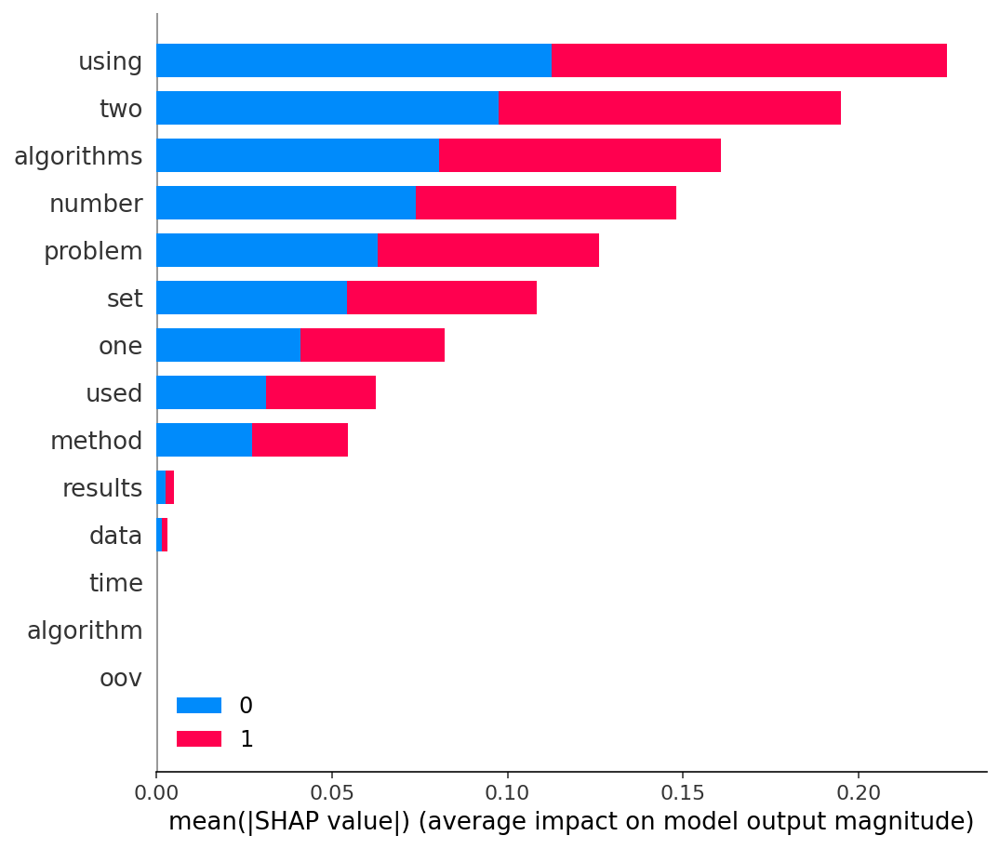

In [184]:
words = word_index
word_lookup = list()
for i in words.keys():
  word_lookup.append(i)
word_lookup = [''] + word_lookup
shap.summary_plot(kernel_shap_values, feature_names=word_lookup, class_names=(0,1))

#Attn bio

In [185]:
x = Input(shape=(15,))

embedding = Embedding(vocab_size, output_dim=EMBEDDING_DIM, 
                    weights=[embedding_matrix_bv], input_length=15, trainable=True)(x)

encoder = Bidirectional(LSTM(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1))(embedding)
encoder = LSTM(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1)(encoder)

decoder = LSTM(128, recurrent_dropout=0.35, dropout=0.3, return_sequences=True)(embedding)
decoder = LSTM(128, recurrent_dropout=0.35, dropout=0.3, return_sequences=True)(decoder)

attention = Attention()([encoder, decoder])

decoder_concat_input = Concatenate()([decoder, attention])

flatten = Flatten()(decoder_concat_input)

y = Dense(2, activation='softmax')(flatten)

model = Model(inputs=x, outputs=y)
model.summary()
opt = keras.optimizers.Adam(learning_rate=0.01)
model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
earlystop_cb = [keras.callbacks.EarlyStopping(patience = 10,monitor='val_accuracy'),keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy',
                                factor=0.1, patience=5, min_lr=1e-3)] 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 15)]         0           []                               
                                                                                                  
 embedding_14 (Embedding)       (None, 15, 200)      978200      ['input_1[0][0]']                
                                                                                                  
 lstm_11 (LSTM)                 (None, 15, 128)      168448      ['embedding_14[0][0]']           
                                                                                                  
 bidirectional_4 (Bidirectional  (None, 15, 256)     336896      ['embedding_14[0][0]']           
 )                                                                                            

In [186]:
num_epochs = 50
history = model.fit(X_train, y_train,
                       epochs=num_epochs,
                       validation_split=0.2
                       , callbacks=[earlystop_cb],verbose=2)

Epoch 1/50
86/86 - 47s - loss: 0.6231 - accuracy: 0.6693 - val_loss: 0.5237 - val_accuracy: 0.7558 - lr: 0.0100 - 47s/epoch - 550ms/step
Epoch 2/50
86/86 - 32s - loss: 0.2442 - accuracy: 0.9076 - val_loss: 0.5763 - val_accuracy: 0.7573 - lr: 0.0100 - 32s/epoch - 376ms/step
Epoch 3/50
86/86 - 32s - loss: 0.0999 - accuracy: 0.9640 - val_loss: 0.6450 - val_accuracy: 0.7529 - lr: 0.0100 - 32s/epoch - 375ms/step
Epoch 4/50
86/86 - 32s - loss: 0.0556 - accuracy: 0.9814 - val_loss: 1.1264 - val_accuracy: 0.7587 - lr: 0.0100 - 32s/epoch - 377ms/step
Epoch 5/50
86/86 - 32s - loss: 0.0358 - accuracy: 0.9884 - val_loss: 1.1754 - val_accuracy: 0.7544 - lr: 0.0100 - 32s/epoch - 370ms/step
Epoch 6/50
86/86 - 32s - loss: 0.0329 - accuracy: 0.9909 - val_loss: 0.9729 - val_accuracy: 0.7631 - lr: 0.0100 - 32s/epoch - 367ms/step
Epoch 7/50
86/86 - 32s - loss: 0.0246 - accuracy: 0.9927 - val_loss: 1.6910 - val_accuracy: 0.7718 - lr: 0.0100 - 32s/epoch - 376ms/step
Epoch 8/50
86/86 - 32s - loss: 0.0197 - a

In [187]:
prediction = model.predict(X_test)
y_pred=np.argmax(prediction, axis=1)
cm = confusion_matrix(y_true=y_test, y_pred=y_pred)

Confusion matrix, without normalization
[[339 109]
 [ 83 329]]


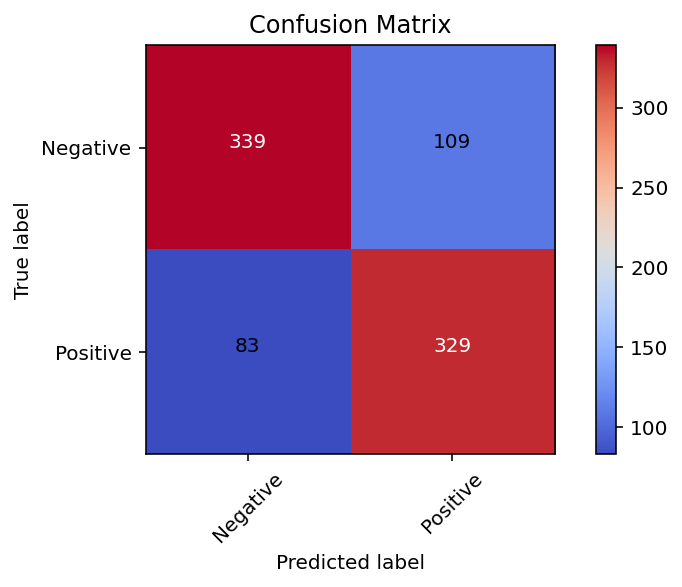

In [188]:
plot_confusion_matrix(cm=cm, classes=cm_labels_plot, title='Confusion Matrix')

In [189]:
report = classification_report(y_test,y_pred,target_names=['Negative','Positive'])
print(report)

              precision    recall  f1-score   support

    Negative       0.80      0.76      0.78       448
    Positive       0.75      0.80      0.77       412

    accuracy                           0.78       860
   macro avg       0.78      0.78      0.78       860
weighted avg       0.78      0.78      0.78       860



In [190]:
attn_scores_df_bio = pd.DataFrame(
    dict(

        acc_test= accuracy_score(y_test, y_pred),
        F1_score = f1_score(y_test, y_pred),
        recall = recall_score(y_test,y_pred),
        precision = precision_score(y_test, y_pred),
        MCC = matthews_corrcoef(y_test, y_pred)
    ), 
    index=['Bilstm EDA Bio']
)
attn_scores_df_bio

,acc_test,F1_score,recall,precision,MCC
Bilstm EDA Bio,0.776744,0.774118,0.798544,0.751142,0.554849


##Lime

In [191]:
exp=explainer.explain_instance(all_df['text'][3228], new_predict).show_in_notebook(text=True)#1

In [192]:
exp=explainer.explain_instance(all_df['text'][1995], new_predict).show_in_notebook(text=True)#1

In [193]:
exp=explainer.explain_instance(all_df['text'][2035], new_predict,).show_in_notebook(text=True)#0

##Shap

In [194]:
tex=[3228,1995,2035]

In [195]:
df=all_df.iloc[tex]

In [196]:
X_values = to_shap(df)
df_shap = func(X_values)

In [197]:
kernel_explainer = shap.KernelExplainer(model.predict, shap.sample(X_train, 100))
kernel_shap_values = kernel_explainer.shap_values(df_shap)

  0%|          | 0/3 [00:00<?, ?it/s]

In [198]:
shap.initjs()
# create dict to invert word_idx k,v order
num2word = {}
for w in word_index.keys():
    num2word[word_index[w]] = w
x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "oov"), df_shap[i]))) for i in range(3)])

In [199]:
shap.initjs()
class_num = 1
input_num = 0
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [200]:
shap.initjs()
class_num = 1
input_num = 1
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

In [201]:
shap.initjs()
class_num = 1
input_num = 2
shap.force_plot(kernel_explainer.expected_value[class_num], kernel_shap_values[class_num][input_num], x_test_words[input_num])

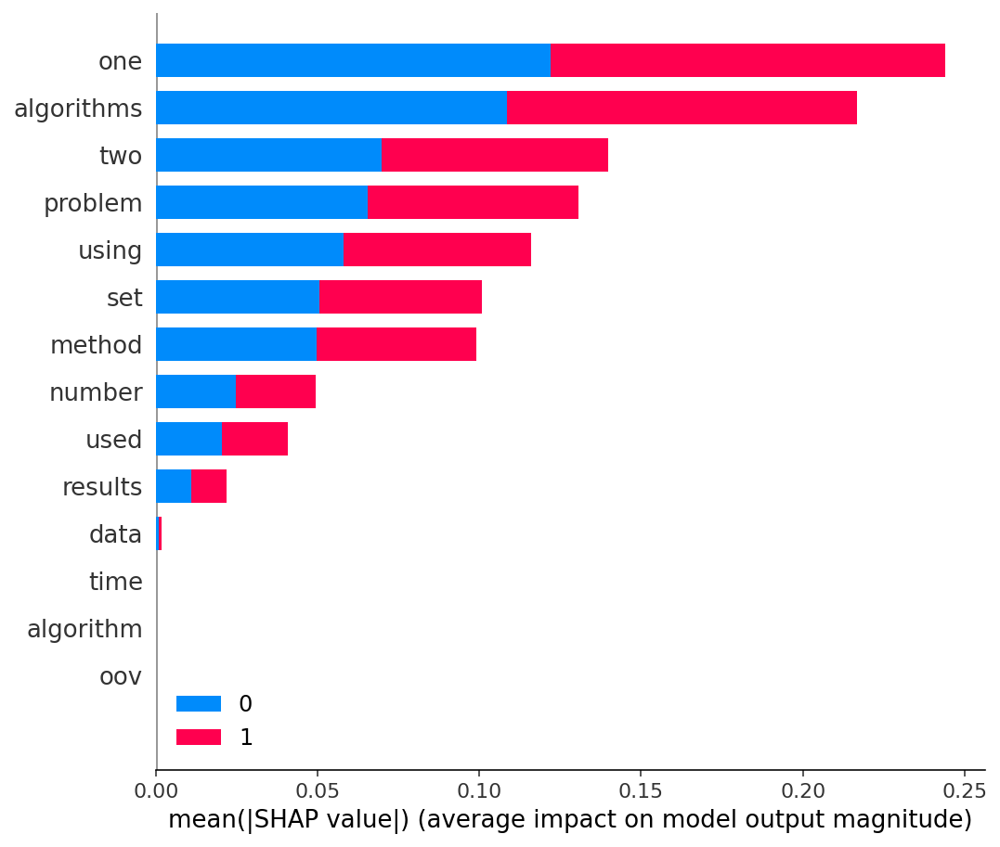

In [202]:
words = word_index
word_lookup = list()
for i in words.keys():
  word_lookup.append(i)
word_lookup = [''] + word_lookup
shap.summary_plot(kernel_shap_values, feature_names=word_lookup, class_names=(0,1))

##BIO scores

In [ ]:
Bioscores_df = pd.concat(
    [
        cnn_scores_df_bio,lstm_scores_df_bio,bilstm_scores_df_bio,gru_scores_df_bio,attn_scores_df_bio
    ],
    axis='rows'
)
Bioscores_df.sort_values('F1_score', ascending=False)

,micro_acc_test,macro_acc_test,F1_score,recall,precision
GRU Bio,0.801860,0.801162,0.791381,0.801860,0.801806
Bilstm EDA Bio,0.792558,0.790907,0.776329,0.792558,0.793134
Bilstm Bio,0.787907,0.785116,0.764463,0.787907,0.790785
LSTM Bio,0.776744,0.775182,0.760000,0.776744,0.777088
CNN Bio,0.772093,0.770562,0.755245,0.772093,0.772373
